# Introduction to Dry Bean Classification

Maintaining the purity of crop varieties is crucial in the global agricultural sector. It helps increase germination rates, crop yields during harvesting, and overall seed quality. Traditionally, achieving this purity involves manual sorting of seeds into various classes, which can be labor-intensive and challenging.

In this project, we leverage **machine learning techniques** to accurately classify commercial dry beans into seven distinct categories:

1. **Cranberry Beans (Barbunya)**
2. **Bombay Kidney Beans**
3. **Cali Beans**
4. **Dermason Kidney Beans**
5. **Horoz Beans**
6. **Seker Beans**
7. **Sira Beans**

## Dataset and Features

The dataset used for this classification task consists of **16 features** extracted from images of approximately 13,611 sample seeds. These features were obtained by analyzing the shape forms and dimensions of the seeds using a computer vision system.

## Methodology

Our approach involves the following steps:

1. **Exploratory Data Analysis (EDA)**:
   - We performed EDA using **pair plots** and **box plots** to understand feature relationships and identify potential outliers or patterns.

2. **Feature Correlation Handling**:
   - To address highly correlated features, we removed one of the two features with a correlation of 1. This step reduces redundancy and improves model interpretability.

3. **Pipeline Creation**:
   - We established a **pipeline** for our machine learning models. Pipelines ensure consistent preprocessing steps during training and testing.

4. **Imputation of Missing Values**:
   - We applied imputation techniques to handle missing values, maintaining data integrity and preventing bias.

5. **MinMax Scaling**:
   - Features were normalized using **MinMax scaling** to a specific range (usually [0, 1]). This benefits models sensitive to feature scales, such as k-nearest neighbors (KNN) and support vector machines (SVM).

6. **SMOTE for Imbalanced Data**:
   - We selectively used **SMOTE (Synthetic Minority Oversampling Technique)** to address class imbalance. Some models benefit from SMOTE, while others may not.

7. **Machine Learning Techniques**:
   - We apply five different machine learning techniques to create models for accurate classification:
     - **Support Vector Machine (SVM)**
     - **Logistic Regression**
     - **K-Nearest Neighbors (KNN)**
     - **Random Forest Trees**
     - **XGBoost**



In [1]:
# Import necessary libraries
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt 
import seaborn as sns
import openpyxl
import os
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import MinMaxScaler
from sklearn.decomposition import PCA
from sklearn.compose import ColumnTransformer
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import confusion_matrix
from sklearn import metrics
from sklearn.model_selection import cross_val_score
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
import xgboost as xgb
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.linear_model import LogisticRegression
from sklearn.neural_network import MLPClassifier
import time

C:\Users\98991\AppData\Local\Temp\ipykernel_20296\4004273709.py:3: DeprecationWarning: 
Pyarrow will become a required dependency of pandas in the next major release of pandas (pandas 3.0),
(to allow more performant data types, such as the Arrow string type, and better interoperability with other libraries)
but was not found to be installed on your system.
If this would cause problems for you,
please provide us feedback at https://github.com/pandas-dev/pandas/issues/54466
        
  import pandas as pd


In [2]:
# Load the data from the Excel file 'Dry_Bean_Dataset.xlsx'
file_path = os.path.abspath('D:\\kaggle\\home_prediction_advance_reg\\Dry_Bean_Dataset.xlsx')
Bean = pd.read_excel(file_path)

<Figure size 1000x600 with 0 Axes>

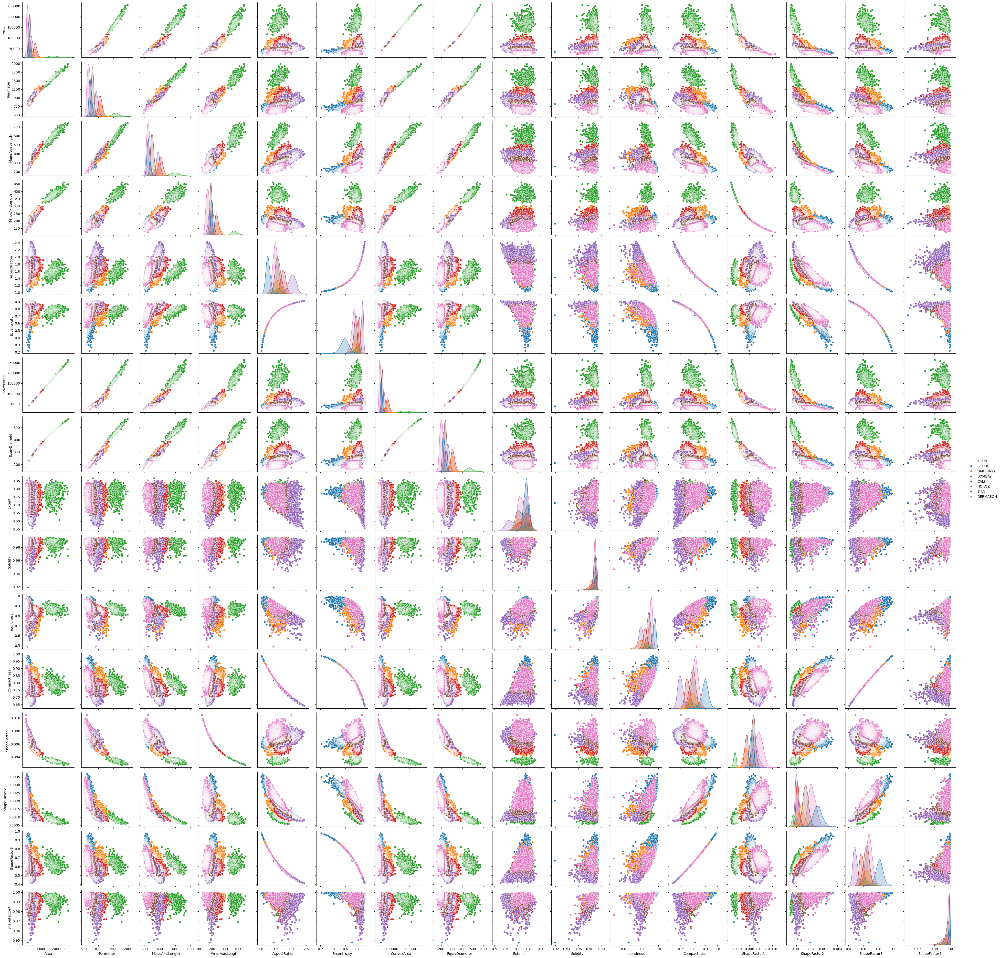

In [16]:
plt.figure(figsize=(10, 6))
sns.pairplot(Bean, hue='Class',)

# Interpretation of Pair Plot

The pair plot provides valuable insights into the relationships between different features in our dry bean dataset. Here are our key observations:

1. **BOMBAY Bean**:
   - The BOMBAY bean class is **distinctly separated** from other classes in most scatter plots.
   - This clear separation suggests that our model will likely perform well in predicting BOMBAY beans.

2. **SIRA and DERMASON Beans**:
   - Unfortunately, the SIRA and DERMASON bean classes exhibit **significant overlap** in feature space.
   - The close proximity of data points for these two classes poses a challenge for our models.
   - We anticipate that distinguishing between SIRA and DERMASON beans accurately will be difficult.

## Implications for Modeling

1. **Model Strengths**:
   - Our model should excel in identifying BOMBAY beans due to their distinctiveness.
   - Features contributing to BOMBAY classification are likely well-defined.

2. **Model Challenges**:
   - Discriminating between SIRA and DERMASON beans will be a **tough task**.
   - We may need additional feature engineering or more sophisticated models to improve classification accuracy for these overlapping classes.


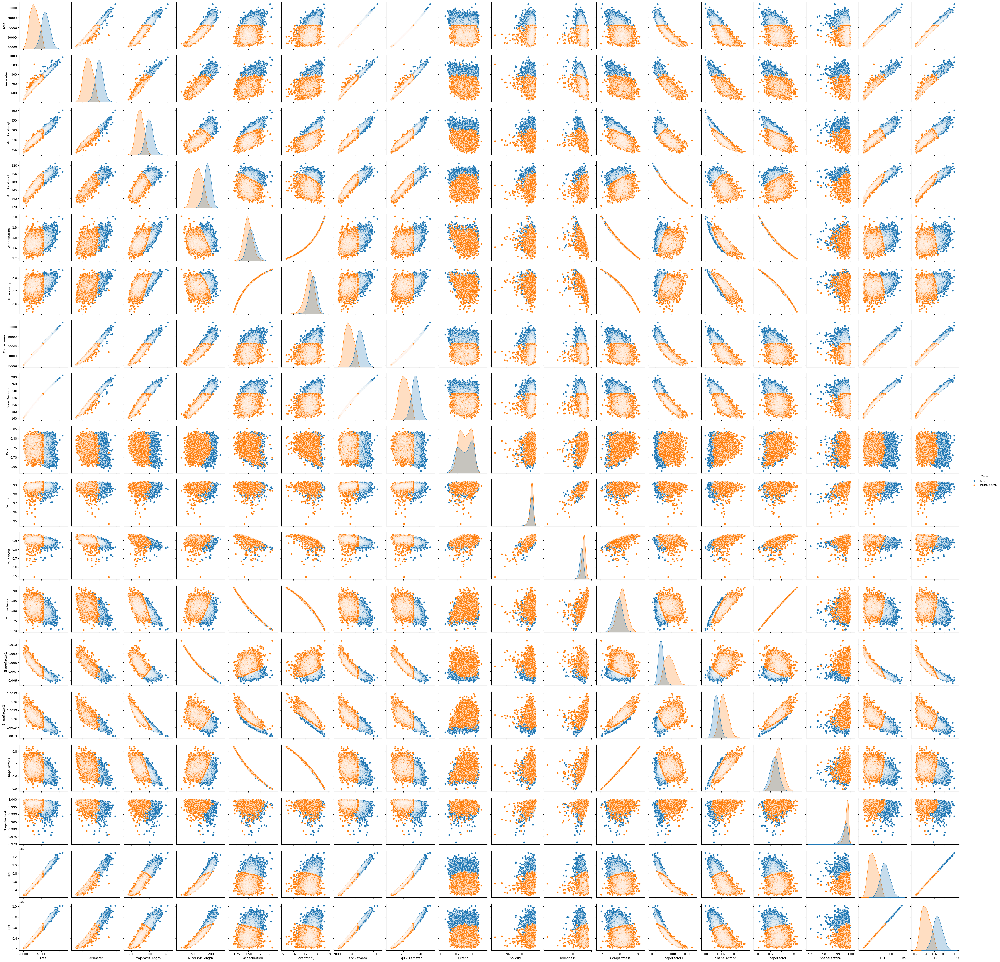

In [115]:
mask= Bean['Class'].isin(['SIRA', 'DERMASON'])
Bean[mask]
sns.pairplot(Bean[mask], hue='Class',)

In [20]:
Bean['Class'].value_counts()
Bean.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13611 entries, 0 to 13610
Data columns (total 17 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Area             13611 non-null  int64  
 1   Perimeter        13611 non-null  float64
 2   MajorAxisLength  13611 non-null  float64
 3   MinorAxisLength  13611 non-null  float64
 4   AspectRation     13611 non-null  float64
 5   Eccentricity     13611 non-null  float64
 6   ConvexArea       13611 non-null  int64  
 7   EquivDiameter    13611 non-null  float64
 8   Extent           13611 non-null  float64
 9   Solidity         13611 non-null  float64
 10  roundness        13611 non-null  float64
 11  Compactness      13611 non-null  float64
 12  ShapeFactor1     13611 non-null  float64
 13  ShapeFactor2     13611 non-null  float64
 14  ShapeFactor3     13611 non-null  float64
 15  ShapeFactor4     13611 non-null  float64
 16  Class            13611 non-null  object 
dtypes: float64(1

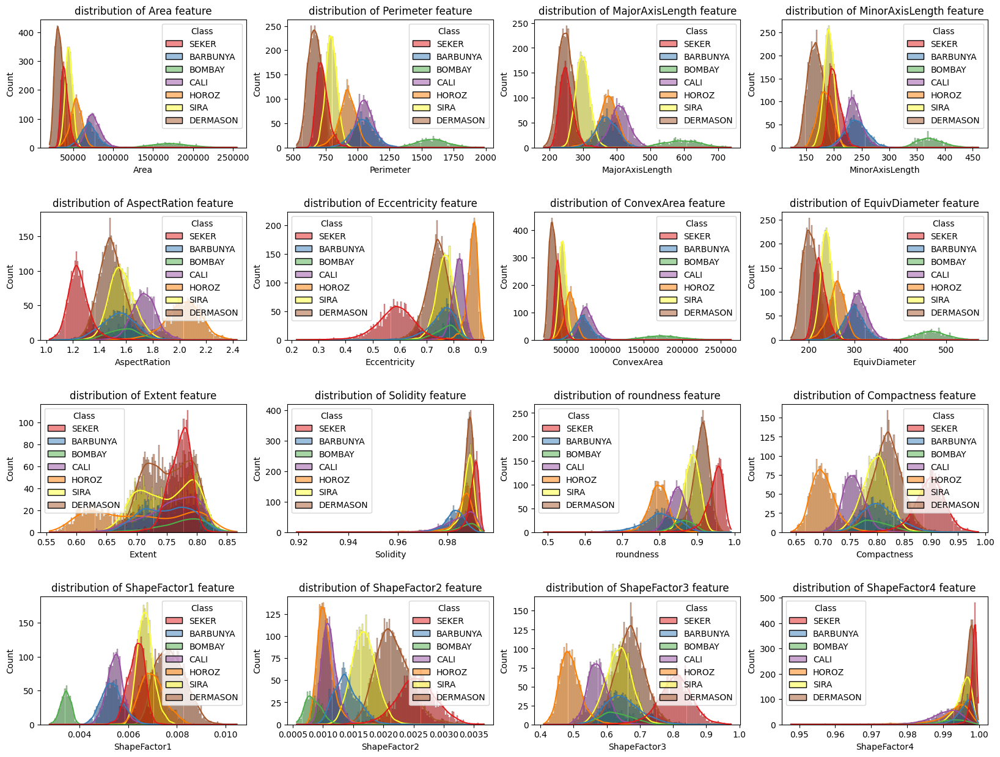

In [3]:


feature_columns=['Area', 'Perimeter', 'MajorAxisLength', 'MinorAxisLength',
       'AspectRation', 'Eccentricity', 'ConvexArea', 'EquivDiameter', 'Extent',
       'Solidity', 'roundness', 'Compactness', 'ShapeFactor1', 'ShapeFactor2',
       'ShapeFactor3', 'ShapeFactor4']

class_palette = sns.color_palette("Set1", n_colors=len(Bean["Class"].unique()))
fig, axes = plt.subplots(nrows=4, ncols=4, figsize=(20, 15))
plt.subplots_adjust(hspace=0.5)

for i, col in enumerate(feature_columns):
    row, column = divmod(i, 4) 
    sns.histplot(data=Bean, bins=150, x=(col), ax=axes[row, column], hue='Class', palette=class_palette, kde=True)
    axes[row, column].set_title(f"distribution of {col} feature")
    
plt.show()

# Correlation Heatmap for Dry Bean Features

The correlation heatmap visually represents the relationships between different numerical features in our dry bean dataset. Here are the key points to consider:

1. **Interpreting the Heatmap**:
   - The color intensity in the heatmap indicates the strength of correlation between pairs of features.
   - Brighter colors (e.g., red or blue) represent stronger correlations, while lighter colors indicate weaker or no correlation.

2. **Highly Correlated Features**:
   - Observe pairs of features with **high positive or negative correlations** (values close to 1 or -1).
   - These highly correlated features may provide redundant information. For instance, if two features are almost perfectly correlated (correlation coefficient ≈ 1), keeping both might not be necessary.

3. **Threshold for Removal**:
   - We did not remove other highly correlated features as we see in our training, it may worsen the model accuracy.

4. **Handling Correlated Features**:
   - **Delete Features with Correlation of 1**: If two features have a correlation coefficient of 1, they are essentially the same. Keep only one of them.
   - **Retain Features with High Importance**: If two features are highly correlated but both provide unique information, consider keeping both.
   - **Feature Selection**: As there were only 16 features we decide to keep them all.

## Action Steps

1. **Identify Highly Correlated Pairs**:
   - Look for bright spots in the heatmap where features are closely aligned.
   - Note down the feature pairs with strong correlations.

2. **Remove Redundant Features**:
   - If necessary, drop features with high correlations (above the chosen threshold).


<Axes: >

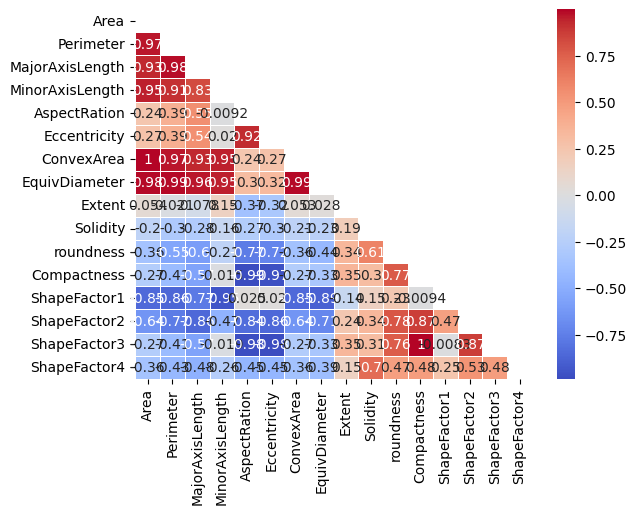

In [4]:
numeric_columns = Bean.drop(columns=['Class'])
correlation_matrix =np.triu(numeric_columns.corr())
sns.heatmap(numeric_columns.corr(), mask= correlation_matrix,annot=True, cmap='coolwarm', linewidths=0.5)

<Axes: >

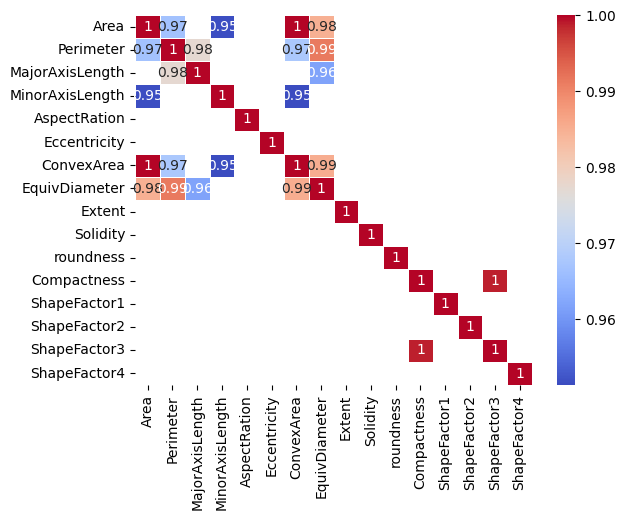

In [5]:
correlation_matrix = numeric_columns.corr()
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', linewidths=0.5,
            mask=correlation_matrix < 0.95)

C:\Users\98991\AppData\Local\Temp\ipykernel_312\3032733716.py:13: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=Bean, x="Class", y=col, ax=axes[row, column], palette=class_palette)
C:\Users\98991\AppData\Local\Temp\ipykernel_312\3032733716.py:13: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=Bean, x="Class", y=col, ax=axes[row, column], palette=class_palette)
C:\Users\98991\AppData\Local\Temp\ipykernel_312\3032733716.py:13: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=Bean, x="Class", y=col, ax=axes[row, column], palette=clas

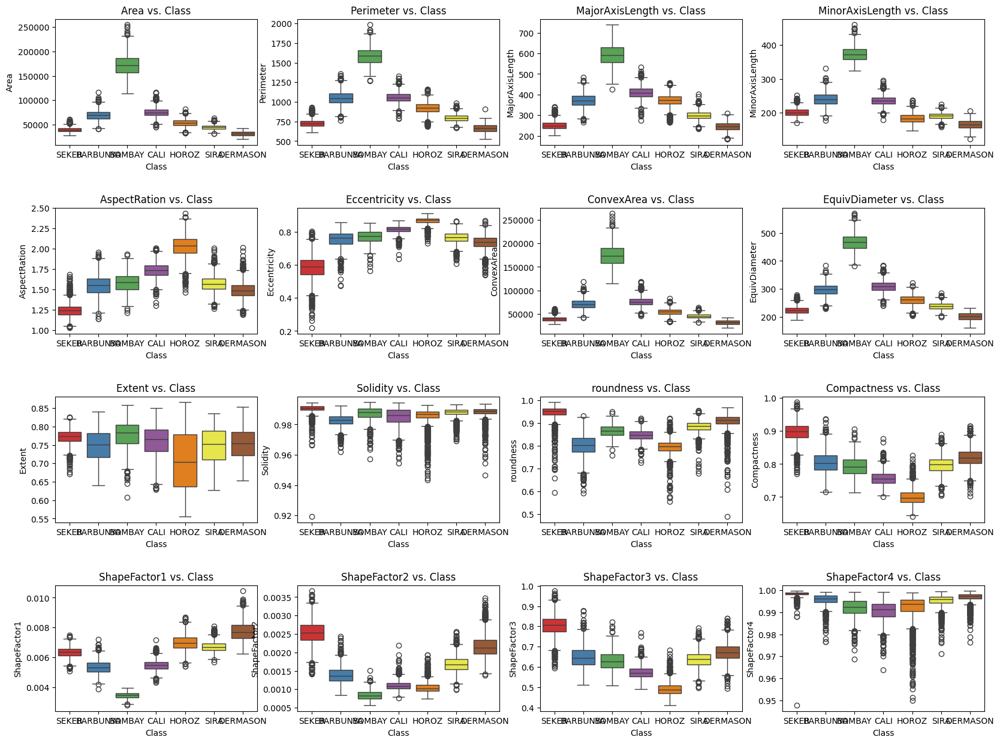

In [6]:
feature_columns=['Area', 'Perimeter', 'MajorAxisLength', 'MinorAxisLength',
       'AspectRation', 'Eccentricity', 'ConvexArea', 'EquivDiameter', 'Extent',
       'Solidity', 'roundness', 'Compactness', 'ShapeFactor1', 'ShapeFactor2',
       'ShapeFactor3', 'ShapeFactor4']

class_palette = sns.color_palette("Set1", n_colors=len(Bean["Class"].unique()))
fig, axes = plt.subplots(nrows=4, ncols=4, figsize=(20, 15))
plt.subplots_adjust(hspace=0.5)

for i, col in enumerate(feature_columns):
    row, column = divmod(i, 4)  # Calculate row and column indices
    sns.boxplot(data=Bean, x="Class", y=col, ax=axes[row, column], palette=class_palette)
    axes[row, column].set_title(f"{col} vs. Class")
    axes[row, column].set_xlabel("Class")
    axes[row, column].set_ylabel(col)

plt.show()

# Selected Features for Dry Bean Classification

In our dry bean classification model, we have carefully chosen a subset of features to include in our pipeline. These features are essential for predicting the bean class accurately. Here's the list of selected columns:

1. **Area**
2. **MajorAxisLength**
3. **AspectRation**
4. **Eccentricity**
5. **Extent**
6. **Solidity**
7. **Roundness**
8. **Compactness**
9. **ShapeFactor1**
10. **ShapeFactor2**
11. **ShapeFactor4**
12. **Perimeter**
13. **EquivDiameter**
14. **MinorAxisLength**

## Feature Selection Strategy

1. **Correlation Analysis**:
   - We examined the correlations between features.
   - Features with a correlation coefficient of 1 (perfect correlation) were considered redundant. We retained only one of them.
   - Features with high importance for classification were retained, even if they were correlated.

2. **Model Efficiency**:
   - By selecting relevant features, we aim to improve model efficiency and reduce noise.

In [4]:
numeric_col=['Area', 'MajorAxisLength', 'AspectRation',
             'Eccentricity', 'Extent', 'Solidity', 'roundness', 
             'Compactness', 'ShapeFactor1', 'ShapeFactor2', 'ShapeFactor4', 'Perimeter', 'EquivDiameter', 'MinorAxisLength']

# Train-Validation Split for Dry Bean Classification

In our dry bean classification task, we split the dataset into training and validation subsets. Here's how we did it:

1. **Dataset**:
   - We have a dataset containing various features (X) and the corresponding bean class labels (y).

2. **Splitting Strategy**:
   - We used the `train_test_split` function from Scikit-learn to split the data.
   - The dataset was divided into training (X_train, y_train) and validation (X_valid, y_valid) subsets.
   - The split ratio was set to 85% training data and 15% validation data.

3. **Randomness Control**:
   - We set a random seed (`random_state=0`) to ensure reproducibility.
   - This ensures that the same split is obtained each time we run the code.

## Implications for Model Training

1. **Training Set (X_train, y_train)**:
   - The training set is used to train our classification model.
   - The model learns from this data to make accurate predictions.

2. **Validation Set (X_valid, y_valid)**:
   - The validation set is used to evaluate the model's performance.
   - We assess how well the model generalizes to unseen data.



In [5]:

X = Bean.drop(columns=['Class'], axis=1)
y = Bean['Class']
X_train, X_valid, y_train, y_valid= train_test_split(X, y, random_state=0, train_size=0.85, stratify=y)

# Addressing Class Imbalance with SMOTE

In our dry bean classification task, we encountered class imbalance, where certain bean classes are underrepresented. To mitigate this issue, we applied the Synthetic Minority Oversampling Technique (SMOTE). Here's how we did it:

1. **SMOTE (Synthetic Minority Oversampling Technique)**:
   - SMOTE generates synthetic samples for the minority class by interpolating between existing data points.
   - It creates new instances of the minority class to balance the class distribution.

2. **Implementation**:
   - We used the `SMOTE` class from the `imblearn.over_sampling` module.
   - The `sampling_strategy` was set to `'auto'`, which automatically adjusts the number of synthetic samples.
   - A random seed (`random_state=0`) was used for reproducibility.

3. **Result**:
   - The training set (`X_train_smote`, `y_train_smote`) now has a balanced class distribution.
   - Our model will be better equipped to learn from both majority and minority classes.



In [6]:
smote = SMOTE(sampling_strategy='auto', random_state=0)
X_train_smote, y_train_smote = smote.fit_resample(X_train, y_train)

# Principal Component Analysis (PCA) for Dimensionality Reduction

In our dry bean classification project, we applied Principal Component Analysis (PCA) to reduce the dimensionality of our feature space. Here's how we approached it:

1. **PCA Overview**:
   - PCA is a technique used to transform high-dimensional data into a lower-dimensional space while preserving as much variance as possible.
   - It identifies the most important features (principal components) that explain the majority of the variance in the data.

2. **Explained Variance**:
   - We calculated the cumulative explained variance ratio for each principal component.
   - The cumulative explained variance shows how much of the total variance in the data is captured by adding more components.

3. **Choosing the Number of Components**:
   - We plotted the cumulative explained variance against the number of components.
   - The "elbow point" in the plot helps us decide how many components to retain.
   - In our case, we achieved an impressive 99.98% variance explained with a certain number of components.

4. **Model Impact**:
   - While PCA reduces dimensionality, it can impact model performance.
   - We will apply it and test if it actually worth using in our dataset.



In [7]:
pca_raw= PCA().fit(X)

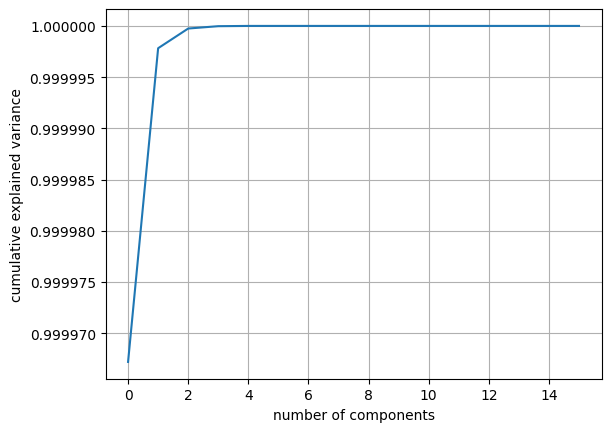

In [8]:
plt.plot(np.cumsum(pca_raw.explained_variance_ratio_))
plt.grid()
plt.ticklabel_format(useOffset=False)
plt.xlabel('number of components')
plt.ylabel('cumulative explained variance');

# Data Preprocessing Pipeline with Transformers

In our dry bean classification project, we've designed a data preprocessing pipeline to transform the original features. Here's how we've structured it:

1. **Feature Transformation**:
   - We apply specific transformations to the numerical features before feeding them into our model.
   - These transformations enhance model performance and ensure consistent data processing.

2. **Pipeline Components**:
   - Our pipeline consists of the following components:
     - **Log Transformation**: We apply a logarithmic transformation using `np.log1p` to handle skewed data.
     - **Imputation**: Missing values are imputed using the mean value of each feature.
     - **Scaling**: Features are scaled to a common range using `MinMaxScaler`.
     - **PCA (Principal Component Analysis)**: We reduce dimensionality using PCA with 2 components.

3. **Column Transformers**:
   - We use `ColumnTransformer` to apply different preprocessing steps to specific columns.
   - `col_transfered` applies the pipeline to the selected numeric columns.
   - `col_transfered_pca` additionally includes PCA for dimensionality reduction.

## Model Training Considerations

1. **Model Input**:
   - Our transformed features (`col_transfered` or `col_transfered_pca`) serve as input to our classification model.
   - The model learns from these processed features.


In [9]:
pca=PCA(n_components=2)

num_pipeline = Pipeline(
    steps=[ 
           ("impute", SimpleImputer(strategy="mean")), ("scale", MinMaxScaler())]
)
num_pipeline_pca = Pipeline(
    steps=[("impute", SimpleImputer(strategy="mean")), ("scale", MinMaxScaler()), ('pca', pca)]
)

In [10]:
col_transfered = ColumnTransformer(

    transformers=[
            ("num_pipeline", num_pipeline, numeric_col)
    ]
)

col_transfered_pca = ColumnTransformer(

    transformers=[
            ("num_pipeline", num_pipeline_pca, numeric_col)
    ]
)

# Model Training and Assessment Process

In our dry bean classification project, we'll systematically train and evaluate several machine learning models. Here's the step-by-step process we'll follow for each model:

1. **Naive Model (Baseline)**:
   - We'll start with a simple, untuned model (e.g., default settings).
   - This serves as our baseline to compare against more sophisticated models.

2. **Hyperparameter Tuning with Grid Search**:
   - We'll use `GridSearchCV` to explore different hyperparameters for each model.
   - Grid search helps us find the best combination of hyperparameters by evaluating performance on validation data.

3. **Final Model Creation**:
   - After hyperparameter tuning, we'll create the final model using the best parameters.
   - This model will be ready for predictions on unseen data.

4. **Model Assessment**:
   - We'll evaluate each model's performance using metrics such as accuracy, precision, recall, F1-score, and ROC curves.
   - Additionally, we'll plot confusion matrices to assess class-wise performance.

## Models in Sequence

1. **K-Nearest Neighbors (KNN)**:
   - Naive KNN model ➡ Hyperparameter tuning ➡ Final KNN model

2. **Support Vector Machine (SVM)**:
   - Naive SVM model ➡ Hyperparameter tuning ➡ Final SVM model

3. **Random Forest**:
   - Naive Random Forest model ➡ Hyperparameter tuning ➡ Final Random Forest model

4. **XGBoost (Extra Boost)**:
   - Naive XGBoost model ➡ Hyperparameter tuning ➡ Final XGBoost model

5. **Logistic Regression**:
   - Naive logistic regression model ➡ Hyperparameter tuning ➡ Final logistic regression model

6. **Multi-Layer Perceptron (MLP)**:
   - Naive MLP model ➡ Hyperparameter tuning ➡ Final MLP model



# K-Nearest Neighbors (KNN) Classification

In this task, we will perform classification using the K-Nearest Neighbors (KNN) algorithm. KNN is a simple and effective algorithm for both binary and multiclass classification tasks.

## Data Preparation

Before training the KNN model, we need to preprocess our dataset. The following steps are performed:

1. **Feature Transformation**: We apply a feature transformation (e.g., scaling, encoding) to prepare the data for modeling.

2. **Model Selection**: We choose the KNN model as our classifier.

3. **Hyperparameter Tuning**: We perform hyperparameter tuning using grid search to find the best hyperparameters for the KNN model.

4. **Model Training**: We train the KNN model on the transformed features.

## KNN Model

### Model Pipeline

We create two pipelines for KNN classification:

1. **KNN Pipeline (Original Features)**:
   - Feature Transformation: `col_transfered` (replace with your actual feature transformation method)
   - Model: KNN Classifier

2. **KNN Pipeline (PCA-Reduced Features)**:
   - Feature Transformation: `col_transfered_pca` (replace with your actual PCA transformation method)
   - Model: KNN Classifier

### Hyperparameter Tuning

We perform grid search to find the best hyperparameters for the KNN model:
- `n_neighbors`: Number of neighbors (1 to 20)
- `p`: Distance metric (1 for Manhattan distance, 2 for Euclidean distance)

### Best Model

After hyperparameter tuning, we obtain the following best models:

1. **KNN Model (Original Features)**:
   - `n_neighbors`: 18
   - `p`: 2 (Euclidean distance)

2. **KNN Model (PCA-Reduced Features)**:
   - `n_neighbors`: 19
   - `p`: 2 (Euclidean distance)



In [11]:
knn_model = KNeighborsClassifier()

knn_pipeline = Pipeline(
    steps= [
        ('transformer', col_transfered),
        ('model', knn_model)
    ]
)

knn_pipeline_pca = Pipeline(
    steps= [
        ('transformer', col_transfered_pca),
        ('model', knn_model)
    ]
)

In [67]:
param_grid_knn = {'model__n_neighbors':np.arange(1,20), 'model__p':[1,2]}


In [68]:
knn_cv= GridSearchCV(knn_pipeline,param_grid_knn,cv=5)
knn_cv.fit(X,y)
print("best score:",knn_cv.best_score_)
print("best parameter:",knn_cv.best_params_)

best score: 0.8546120982632772
best parameter: {'model__n_neighbors': 18, 'model__p': 2}


In [69]:
knn_cv_pca= GridSearchCV(knn_pipeline_pca,param_grid_knn,cv=5)
knn_cv_pca.fit(X,y)


best score: 0.8546120982632772
best parameter: {'model__n_neighbors': 18, 'model__p': 2}


In [82]:
print("best score:",knn_cv_pca.best_score_)
print("best parameter:",knn_cv_pca.best_params_)

best score: 0.7494032249838978
best parameter: {'model__n_neighbors': 19, 'model__p': 2}


In [12]:
knn_model_f= KNeighborsClassifier(n_neighbors=18, p=2)
knn_pipeline_f= Pipeline(
    steps= [
        ('transformer', col_transfered),
        ('model', knn_model_f)
    ]
)

knn_model_f_pca= KNeighborsClassifier(n_neighbors=19, p=2)
knn_pipeline_f_pca= Pipeline(
    steps= [
        ('transformer', col_transfered_pca),
        ('model', knn_model_f_pca)
    ]
)

Prediction completed in 0.28 seconds.


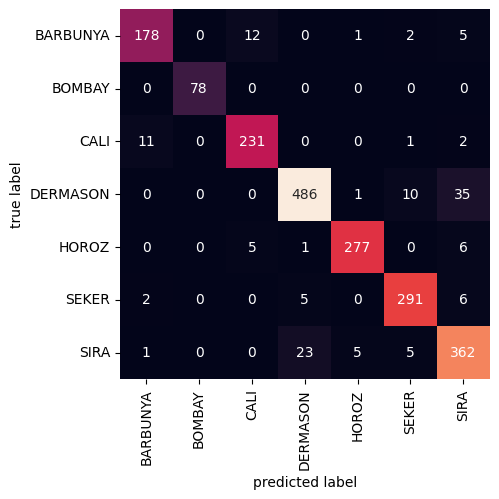

In [13]:
S_time_knn= time.time()
knn_pipeline_f.fit(X_train_smote,y_train_smote)
y_pred_knn= knn_pipeline_f.predict(X_valid)
E_time_knn= time.time()
class_names=['BARBUNYA', 'BOMBAY', 'CALI', 'DERMASON', 'HOROZ', 'SEKER', 'SIRA' ]

mat_knn = confusion_matrix(y_valid, y_pred_knn)
sns.heatmap(mat_knn, square=True, annot=True, fmt='d', cbar=False,xticklabels=class_names, yticklabels=class_names)
plt.ylabel('true label')
plt.xlabel('predicted label')

prediction_runtime = E_time_knn - S_time_knn
print(f"Prediction completed in {prediction_runtime:.2f} seconds.")

Prediction completed in 0.18 seconds.


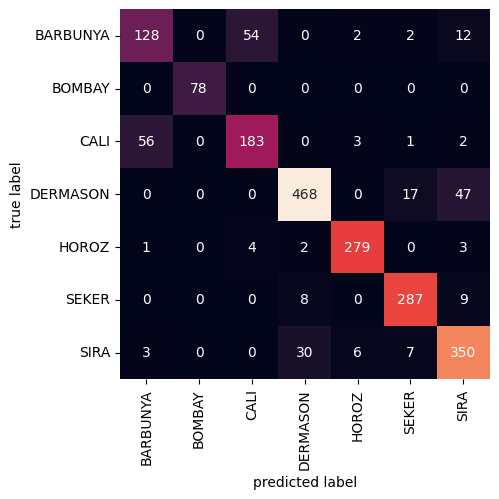

In [162]:
S_time_knn_pca= time.time()
knn_pipeline_f_pca.fit(X_train_smote,y_train_smote)
y_pred_knn_pca= knn_pipeline_f_pca.predict(X_valid)
E_time_knn_pca= time.time()
class_names=['BARBUNYA', 'BOMBAY', 'CALI', 'DERMASON', 'HOROZ', 'SEKER', 'SIRA' ]

mat_knn_pca = confusion_matrix(y_valid, y_pred_knn_pca)
sns.heatmap(mat_knn_pca, square=True, annot=True, fmt='d', cbar=False,xticklabels=class_names, yticklabels=class_names)
plt.ylabel('true label')
plt.xlabel('predicted label')

prediction_runtime = E_time_knn_pca - S_time_knn_pca
print(f"Prediction completed in {prediction_runtime:.2f} seconds.")

In [43]:

print(metrics.classification_report(y_pred_knn, y_valid))

              precision    recall  f1-score   support

    BARBUNYA       0.89      0.93      0.91       191
      BOMBAY       1.00      1.00      1.00        78
        CALI       0.95      0.93      0.94       250
    DERMASON       0.91      0.94      0.92       517
       HOROZ       0.96      0.98      0.97       283
       SEKER       0.95      0.94      0.94       308
        SIRA       0.91      0.87      0.89       415

    accuracy                           0.93      2042
   macro avg       0.94      0.94      0.94      2042
weighted avg       0.93      0.93      0.93      2042



In [159]:
print(metrics.classification_report(y_pred_knn_pca, y_valid))

              precision    recall  f1-score   support

    BARBUNYA       0.65      0.68      0.66       188
      BOMBAY       1.00      1.00      1.00        78
        CALI       0.75      0.76      0.75       241
    DERMASON       0.88      0.92      0.90       508
       HOROZ       0.97      0.96      0.96       290
       SEKER       0.94      0.91      0.93       314
        SIRA       0.88      0.83      0.85       423

    accuracy                           0.87      2042
   macro avg       0.87      0.87      0.87      2042
weighted avg       0.87      0.87      0.87      2042



# K-Nearest Neighbors (KNN) Classification Report Analysis

In this analysis, we compare the performance of K-Nearest Neighbors (KNN) models with and without Principal Component Analysis (PCA). Let's examine the classification reports for both scenarios.

## KNN Model with PCA

### Precision, Recall, and F1-Score

| Class     | Precision | Recall | F1-Score | Support |
| ---       | ---       | ---    | ---      | ---     |
| BARBUNYA  | 0.65      | 0.68   | 0.66     | 188     |
| BOMBAY    | 1.00      | 1.00   | 1.00     | 78      |
| CALI      | 0.75      | 0.76   | 0.75     | 241     |
| DERMASON  | 0.88      | 0.92   | 0.90     | 508     |
| HOROZ     | 0.97      | 0.96   | 0.96     | 290     |
| SEKER     | 0.94      | 0.91   | 0.93     | 314     |
| SIRA      | 0.88      | 0.83   | 0.85     | 423     |

### Overall Metrics

- Accuracy: 0.87
- Macro Avg F1-Score: 0.87
- Weighted Avg F1-Score: 0.87
- Overall runtime: 0.18s

## KNN Model without PCA

### Precision, Recall, and F1-Score

| Class     | Precision | Recall | F1-Score | Support |
| ---       | ---       | ---    | ---      | ---     |
| BARBUNYA  | 0.89      | 0.93   | 0.91     | 191     |
| BOMBAY    | 1.00      | 1.00   | 1.00     | 78      |
| CALI      | 0.95      | 0.93   | 0.94     | 250     |
| DERMASON  | 0.91      | 0.94   | 0.92     | 517     |
| HOROZ     | 0.96      | 0.98   | 0.97     | 283     |
| SEKER     | 0.95      | 0.94   | 0.94     | 308     |
| SIRA      | 0.91      | 0.87   | 0.89     | 415     |

### Overall Metrics

- Accuracy: 0.93
- Macro Avg F1-Score: 0.94
- Weighted Avg F1-Score: 0.93
- Overall runtime: 0.28s

## Interpretation

- The KNN model without PCA achieves higher accuracy and F1-scores across most classes.


In [180]:

score_knn= cross_val_score(knn_pipeline_f, X, y, cv=10,)
score_knn

array([0.67180617, 0.86039677, 0.94342395, 0.97060985, 0.97207935,
       0.97207935, 0.96914034, 0.94636297, 0.89419544, 0.6752388 ])

In [181]:
np.mean(score_knn)

0.8875332985916679

# Support Vector Machine (SVC) Classification Report

In this classification task, we trained a Support Vector Machine (SVC) model using the following steps:

1. **Model Training**:
   - We initialized an SVC model with default hyperparameters.
   - The training data was preprocessed using the `col_transfered` feature transformation method (replace with your actual feature transformation).
   - The model was trained on the transformed features.

2. **Hyperparameter Tuning**:
   - We performed grid search using cross-validation to find the best hyperparameters for the SVC model.
   - The hyperparameters considered were `C` (regularization parameter), `gamma` (kernel coefficient), and `kernel` (kernel type).

3. **Best Model**:
   - After hyperparameter tuning, we obtained the best SVC model with the following parameters:
     - `C`: 0.1
     - `kernel`: 'rbf'
     - `gamma`: 1



In [15]:
svc_model = SVC(random_state=0)

svc_pipeline = Pipeline(
    steps= [
        ('transformer', col_transfered),
        ('model', svc_model)
    ]
)


svc_pipeline_pca = Pipeline(
    steps= [
        ('transformer', col_transfered_pca),
        ('model', svc_model)
    ]
)

In [80]:
param_grid_svc = {
    "model__C": [0.1, 1, 10, 100, 1000],
    "model__gamma": [1, 0.1, 0.01, 0.001, 0.0001],
    "model__kernel": ["rbf", "poly", "linear"],
}
svc_cv = GridSearchCV(
    svc_pipeline,
    param_grid=param_grid_svc,
    cv=5,
)

svc_cv_pca = GridSearchCV(
    svc_pipeline_pca,
    param_grid=param_grid_svc,
    cv=5,
)

In [76]:
svc_cv.fit(X,y)
print("best score:",svc_cv.best_score_)
print("best parameter:",svc_cv.best_params_)

best score: 0.8696735269777169
best parameter: {'model__C': 0.1, 'model__gamma': 1, 'model__kernel': 'rbf'}


In [81]:
svc_cv_pca.fit(X,y)

AttributeError: 'GridSearchCV' object has no attribute 'best_score_'

In [85]:

print("best score:",svc_cv_pca.best_score_)
print("best parameter:",svc_cv_pca.best_params_)

best score: 0.8251510319878317
best parameter: {'model__C': 0.1, 'model__gamma': 1, 'model__kernel': 'linear'}


In [16]:
svc_model_f= SVC(random_state=0, C=0.1, kernel='rbf', gamma=1)
svc_pipeline_f = Pipeline(
    steps= [
        ('transformer', col_transfered),
        ('model', svc_model_f)
    ]
)

svc_model_f_pca= SVC(random_state=0, C=0.1, kernel='linear', gamma=1)
svc_pipeline_f_pca = Pipeline(
    steps= [
        ('transformer', col_transfered_pca),
        ('model', svc_model_f_pca)
    ]
)

Prediction completed in 4.43 seconds.


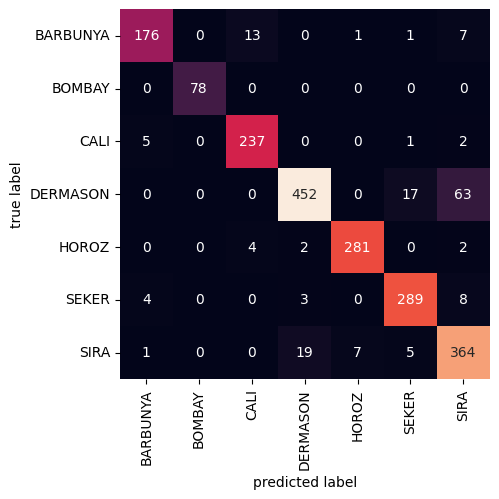

In [17]:
S_time_svc= time.time()
svc_pipeline_f.fit(X_train_smote,y_train_smote)
y_pred_svc= svc_pipeline_f.predict(X_valid)
E_time_svc= time.time()
class_names=['BARBUNYA', 'BOMBAY', 'CALI', 'DERMASON', 'HOROZ', 'SEKER', 'SIRA' ]
mat_svc = confusion_matrix(y_valid, y_pred_svc)
sns.heatmap(mat_svc, square=True, annot=True, fmt='d', cbar=False, xticklabels=class_names, yticklabels=class_names)
plt.ylabel('true label')
plt.xlabel('predicted label')

prediction_runtime = E_time_svc - S_time_svc
print(f"Prediction completed in {prediction_runtime:.2f} seconds.")

Prediction completed in 2.38 seconds.


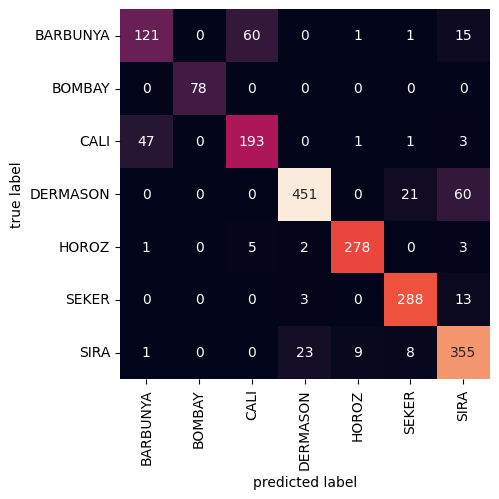

In [192]:
S_time_svc_pca= time.time()
svc_pipeline_f_pca.fit(X_train_smote,y_train_smote)
y_pred_svc_pca= svc_pipeline_f_pca.predict(X_valid)
E_time_svc_pca= time.time()
class_names=['BARBUNYA', 'BOMBAY', 'CALI', 'DERMASON', 'HOROZ', 'SEKER', 'SIRA' ]
mat_svc_pca = confusion_matrix(y_valid, y_pred_svc_pca)
sns.heatmap(mat_svc_pca, square=True, annot=True, fmt='d', cbar=False, xticklabels=class_names, yticklabels=class_names)
plt.ylabel('true label')
plt.xlabel('predicted label')

prediction_runtime = E_time_svc_pca - S_time_svc_pca
print(f"Prediction completed in {prediction_runtime:.2f} seconds.")

In [51]:
print(metrics.classification_report(y_pred_svc, y_valid))

              precision    recall  f1-score   support

    BARBUNYA       0.89      0.95      0.92       186
      BOMBAY       1.00      1.00      1.00        78
        CALI       0.96      0.93      0.95       253
    DERMASON       0.85      0.95      0.90       477
       HOROZ       0.97      0.97      0.97       290
       SEKER       0.94      0.92      0.93       311
        SIRA       0.92      0.81      0.86       447

    accuracy                           0.92      2042
   macro avg       0.93      0.93      0.93      2042
weighted avg       0.92      0.92      0.92      2042



# Support Vector Machine (SVC) Classification Report

In this classification task, we trained a Support Vector Machine (SVC) model with and without Principal Component Analysis (PCA). Let's examine the classification reports for both scenarios.

## SVC Model without PCA

### Precision, Recall, and F1-Score

| Class     | Precision | Recall | F1-Score | Support |
| ---       | ---       | ---    | ---      | ---     |
| BARBUNYA  | 0.89      | 0.95   | 0.92     | 186     |
| BOMBAY    | 1.00      | 1.00   | 1.00     | 78      |
| CALI      | 0.96      | 0.93   | 0.95     | 253     |
| DERMASON  | 0.85      | 0.95   | 0.90     | 477     |
| HOROZ     | 0.97      | 0.97   | 0.97     | 290     |
| SEKER     | 0.94      | 0.92   | 0.93     | 311     |
| SIRA      | 0.92      | 0.81   | 0.86     | 447     |

### Overall Metrics

- Accuracy: 0.92
- Macro Avg F1-Score: 0.93
- Weighted Avg F1-Score: 0.92
- Overall runtime: 4.43s

## SVC Model with PCA

### Precision, Recall, and F1-Score

| Class     | Precision | Recall | F1-Score | Support |
| ---       | ---       | ---    | ---      | ---     |
| BARBUNYA  | 0.61      | 0.71   | 0.66     | 170     |
| BOMBAY    | 1.00      | 1.00   | 1.00     | 78      |
| CALI      | 0.79      | 0.75   | 0.77     | 258     |
| DERMASON  | 0.85      | 0.94   | 0.89     | 479     |
| HOROZ     | 0.96      | 0.96   | 0.96     | 289     |
| SEKER     | 0.95      | 0.90   | 0.92     | 319     |
| SIRA      | 0.90      | 0.79   | 0.84     | 449     |

### Overall Metrics

- Accuracy: 0.86
- Macro Avg F1-Score: 0.86
- Weighted Avg F1-Score: 0.86
- Overall runtime: 2.61s

## Interpretation

- The SVC model without PCA achieves higher accuracy and F1-scores across most classes.


In [182]:
score_svc= cross_val_score(svc_pipeline_f, X, y, cv=10,)
score_svc

array([0.67547724, 0.90374724, 0.96693608, 0.97575312, 0.97501837,
       0.97575312, 0.96473181, 0.95150625, 0.8949302 , 0.65393093])

In [183]:
np.mean(score_svc)

0.8937784366466308

# Impact of PCA Analysis on Model Performance

In this analysis, we compare the effects of Principal Component Analysis (PCA) on the performance of two models: K-Nearest Neighbors (KNN) and Support Vector Machine (SVC).

## Model Comparison

1. **KNN Model with PCA**:
   - The runtime was reduced by approximately half compared to the original time.
   - However, the recall for classes "Cali" and "Barbunya" has significantly worsened.

2. **SVC Model with PCA**:
   - Similar to KNN, the runtime decreased significantly.
   - Unfortunately, the recall for "Cali" and "Barbunya" also deteriorated.

## Conclusion

While PCA effectively reduces dimensionality (99% variance retained), it comes at the cost of recall performance for specific classes. In future models, we will not use PCA for dimensionality reduction.


# Random Forest Classifier (RFC) Model

In this classification task, we trained a Random Forest Classifier (RFC) model using the following steps:

1. **Model Training**:
   - We initialized an RFC model with a random seed of 0.
   - The training data was preprocessed using the `col_transfered` feature transformation method (replace with your actual feature transformation).
   - The model was trained on the transformed features.

2. **Hyperparameter Tuning**:
   - We performed grid search using cross-validation to find the best hyperparameters for the RFC model.
   - The hyperparameters considered were:
     - `n_estimators`: [20, 50, 100, 150]
     - `max_depth`: [None, 10, 20, 50]
     - `bootstrap`: [True, False]

3. **Best Model**:
   - After hyperparameter tuning, we obtained the best RFC model with the following parameters:
     - `n_estimators`: 50
     - `max_depth`: 10
     - `bootstrap`: True


In [19]:
RandF_model = RandomForestClassifier(random_state=0)

RandF_pipeline = Pipeline(
    steps= [
        ('transformer', col_transfered),
        ('model', RandF_model)
    ]
)


In [169]:
param_grid_RandF = {
    "model__n_estimators": [20,50,100,150],
    "model__max_depth": [None, 10, 20, 50],
    "model__bootstrap": [True, False],
}
RandF_cv = GridSearchCV(
    RandF_pipeline,
    param_grid=param_grid_RandF,
    cv=5,
)

RandF_cv.fit(X,y)

KeyboardInterrupt: 

In [50]:
print("best score:",RandF_cv.best_score_)
print("best parameter:",RandF_cv.best_params_)

best score: 0.6668995410958922
best parameter: {'model__bootstrap': True, 'model__max_depth': 10, 'model__n_estimators': 100}


In [20]:
RandF_model_f=RandomForestClassifier(bootstrap=True, max_depth=10, n_estimators=50)
RandF_pipeline_f = Pipeline(
    steps= [
        ('transformer', col_transfered),
        ('model', RandF_model_f)
    ]
)

Prediction completed in 1.64 seconds.


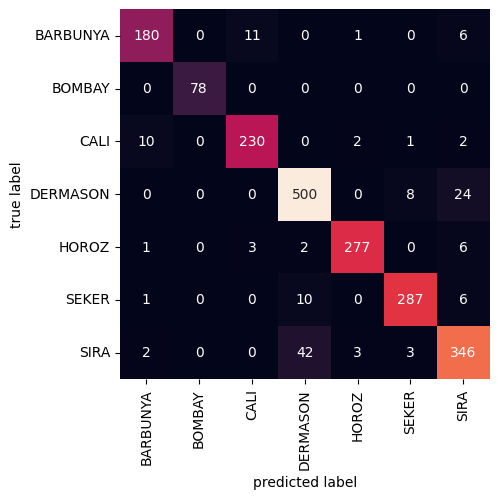

In [21]:
S_time_randf= time.time()
RandF_pipeline_f.fit(X_train,y_train)
y_pred_RandF= RandF_pipeline_f.predict(X_valid)
E_time_randf= time.time()

class_names=['BARBUNYA', 'BOMBAY', 'CALI', 'DERMASON', 'HOROZ', 'SEKER', 'SIRA' ]

mat_RandF = confusion_matrix(y_valid, y_pred_RandF)
sns.heatmap(mat_RandF, square=True, annot=True, fmt='d', cbar=False, xticklabels=class_names, yticklabels=class_names)
plt.ylabel('true label')
plt.xlabel('predicted label')

prediction_runtime = E_time_randf - S_time_randf
print(f"Prediction completed in {prediction_runtime:.2f} seconds.")

In [177]:
print(metrics.classification_report(y_pred_RandF, y_valid))

              precision    recall  f1-score   support

    BARBUNYA       0.91      0.94      0.93       192
      BOMBAY       1.00      1.00      1.00        78
        CALI       0.94      0.95      0.94       243
    DERMASON       0.94      0.90      0.92       553
       HOROZ       0.96      0.98      0.97       282
       SEKER       0.94      0.96      0.95       300
        SIRA       0.88      0.88      0.88       394

    accuracy                           0.93      2042
   macro avg       0.94      0.94      0.94      2042
weighted avg       0.93      0.93      0.93      2042



# Random Forest Classifier (RFC) Classification Report

The classification report for the Random Forest Classifier (RFC) model is as follows:

| Class     | Precision | Recall | F1-Score | Support |
|-----------|-----------|--------|----------|---------|
| BARBUNYA  | 0.91      | 0.94   | 0.93     | 192     |
| BOMBAY    | 1.00      | 1.00   | 1.00     | 78      |
| CALI      | 0.94      | 0.95   | 0.94     | 243     |
| DERMASON  | 0.94      | 0.90   | 0.92     | 553     |
| HOROZ     | 0.96      | 0.98   | 0.97     | 282     |
| SEKER     | 0.94      | 0.96   | 0.95     | 300     |
| SIRA      | 0.88      | 0.88   | 0.88     | 394     |

- Accuracy: 0.93
- Macro Avg F1-Score: 0.94
- Weighted Avg F1-Score: 0.93
- Overall runtime: 1.64s


In [184]:
score_RandF=(cross_val_score(RandF_pipeline, X, y, cv=10))
score_RandF

array([0.47063142, 0.70609846, 0.7707568 , 0.93901543, 0.96840558,
       0.96032329, 0.73622337, 0.70756796, 0.6943424 , 0.3901543 ])

In [185]:
np.mean(score_RandF)

0.7343519007035726

# XGBoost Classifier Model

In this classification task, we trained an XGBoost Classifier (XGBoost) model using the following steps:

1. **Model Training**:
   - We initialized an XGBoost model.
   - The training data was preprocessed using the `col_transfered` feature transformation method (replace with your actual feature transformation).
   - The model was trained on the transformed features.

2. **Hyperparameter Tuning**:
   - We performed grid search using cross-validation to find the best hyperparameters for the XGBoost model.
   - The hyperparameters considered were:
     - `learning_rate`: Ranging from 0.05 to 1 with a step of 0.05
     - `max_depth`: Ranging from 3 to 15
     - `n_estimators`: Ranging from 50 to 200 with a step of 50

3. **Best Model**:
   - After hyperparameter tuning, we obtained the best XGBoost model with the following parameters:
     - `learning_rate`: 0.05
     - `max_depth`: 3
     - `n_estimators`: 50

4. **Target Variable Encoding**:
   - To ensure compatibility with the XGBoost model, we encoded the target variable `y` into numerical values.
     - Class 'BARBUNYA': Encoded as 0
     - Class 'BOMBAY': Encoded as 1
     - Class 'CALI': Encoded as 2
     - Class 'DERMASON': Encoded as 3
     - Class 'HOROZ': Encoded as 4
     - Class 'SEKER': Encoded as 5
     - Class 'SIRA': Encoded as 6

5. **Caution Regarding Label Encoding**:
   - Label encoding can introduce an ordinal relationship among classes that may not exist in reality.
   - For instance, encoding classes as 0, 1, 2, etc., implies an order or ranking, which might mislead the model.
   - Be aware that misleading encoding can impact model performance and lead to less accurate predictions.


In [23]:
xgb_model= xgb.XGBClassifier()
xgb_pipeline= Pipeline(
    steps=[
        ('transformer', col_transfered),
        ('model', xgb_model)
    ]
)
encoder = LabelEncoder()

In [17]:
param_grid_xgb = {
    "model__learning_rate": np.arange(0.05, 1, 0.05),
    "model__max_depth": np.arange(3, 15, 1),
    "model__n_estimators": np.arange(50, 200, 50),
}


y_encode= encoder.fit_transform(y)

xgb_cv = GridSearchCV(
    xgb_pipeline,
    param_grid=param_grid_xgb,
    cv=5,
    scoring='accuracy'
)
xgb_cv.fit(X,y_encode)


GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('transformer',
                                        ColumnTransformer(transformers=[('num_pipeline',
                                                                         Pipeline(steps=[('impute',
                                                                                          SimpleImputer()),
                                                                                         ('scale',
                                                                                          MinMaxScaler())]),
                                                                         ['Area',
                                                                          'MajorAxisLength',
                                                                          'AspectRation',
                                                                          'Eccentricity',
                                                                          'Extent',
                                                                          'Solidity',
                                                                          'roundness',
                                                                          'Compactness',
                                                                          'ShapeFactor1',
                                                                          'ShapeFactor2',
                                                                          'ShapeFactor4',
                                                                          'Perimeter',
                                                                          'EquivDiameter...
                                                      monotone_constraints=None,
                                                      multi_strategy=None,
                                                      n_estimators=None,
                                                      n_jobs=None,
                                                      num_parallel_tree=None,
                                                      random_state=None, ...))]),
             param_grid={'model__learning_rate': array([0.05, 0.1 , 0.15, 0.2 , 0.25, 0.3 , 0.35, 0.4 , 0.45, 0.5 , 0.55,
       0.6 , 0.65, 0.7 , 0.75, 0.8 , 0.85, 0.9 , 0.95]),
                         'model__max_depth': array([ 3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14]),
                         'model__n_estimators': array([ 50, 100, 150])},
             scoring='accuracy')

In [18]:

print("best score:",xgb_cv.best_score_)
print("best parameter:",xgb_cv.best_params_)

best score: 0.7145167178763752
best parameter: {'model__learning_rate': 0.05, 'model__max_depth': 3, 'model__n_estimators': 50}


In [24]:
xgb_model_f= xgb.XGBClassifier(learning_rate = 0.05, max_depth = 3, n_estimators = 50)

xgb_pipeline_f= Pipeline(
    steps=[
        ('transformer', col_transfered),
        ('model', xgb_model_f)
    ]
)

Prediction completed in 1.04 seconds.


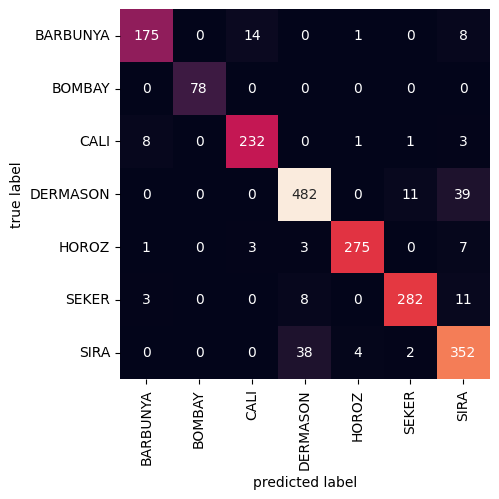

In [25]:
S_time_xgb= time.time()
y_train_encode=encoder.fit_transform(y_train)
y_valid_encode=encoder.fit_transform(y_valid)

xgb_pipeline_f.fit(X_train,y_train_encode)
y_pred_xgb= xgb_pipeline_f.predict(X_valid)
E_time_xgb= time.time()

class_names=['BARBUNYA', 'BOMBAY', 'CALI', 'DERMASON', 'HOROZ', 'SEKER', 'SIRA' ]

mat_xgb = confusion_matrix(y_valid_encode, y_pred_xgb)
sns.heatmap(mat_xgb, square=True, annot=True, fmt='d', cbar=False, xticklabels=class_names, yticklabels=class_names)
plt.ylabel('true label')
plt.xlabel('predicted label')

prediction_runtime = E_time_xgb - S_time_xgb
print(f"Prediction completed in {prediction_runtime:.2f} seconds.")

In [39]:
print(metrics.classification_report(y_pred_xgb, y_valid_encode))

              precision    recall  f1-score   support

           0       0.88      0.94      0.91       187
           1       1.00      1.00      1.00        78
           2       0.95      0.93      0.94       249
           3       0.91      0.91      0.91       531
           4       0.95      0.98      0.96       281
           5       0.93      0.95      0.94       296
           6       0.89      0.84      0.86       420

    accuracy                           0.92      2042
   macro avg       0.93      0.93      0.93      2042
weighted avg       0.92      0.92      0.92      2042



# XGBoost Classifier Model Classification Report

The classification report for the XGBoost Classifier (XGBoost) model is as follows:

| Class     | Precision | Recall | F1-Score | Support |
|-----------|-----------|--------|----------|---------|
| BARBUNYA  | 0.88      | 0.94   | 0.91     | 187     |
| BOMBAY    | 1.00      | 1.00   | 1.00     | 78      |
| CALI      | 0.95      | 0.93   | 0.94     | 249     |
| DERMASON  | 0.91      | 0.91   | 0.91     | 531     |
| HOROZ     | 0.95      | 0.98   | 0.96     | 281     |
| SEKER     | 0.93      | 0.95   | 0.94     | 296     |
| SIRA      | 0.89      | 0.84   | 0.86     | 420     |

- Accuracy: 0.92
- Macro Avg F1-Score: 0.93
- Weighted Avg F1-Score: 0.92
- Overall runtime: 1.04s


In [186]:
y_encode= encoder.fit_transform(y)
score_xgb=(cross_val_score(xgb_pipeline_f, X, y_encode, cv=10))
score_xgb

array([0.46035242, 0.75826598, 0.93828068, 0.97281411, 0.97869214,
       0.97575312, 0.96987509, 0.95811903, 0.77002204, 0.32182219])

In [187]:
np.mean(score_xgb)

0.8103996802040478

# Logistic Regression Classifier Model

In this classification task, we trained a Logistic Regression Classifier (Logistic Regression) model using the following steps:

1. **Model Training**:
   - We initialized a Logistic Regression model.
   - The training data was preprocessed using the `col_transfered` feature transformation method (replace with your actual feature transformation).
   - The model was trained on the transformed features.

2. **Hyperparameter Tuning**:
   - We performed grid search using cross-validation to find the best hyperparameters for the Logistic Regression model.
   - The hyperparameters considered were:
     - `penalty`: Regularization type (L1 or L2)
     - `C`: Inverse of regularization strength (ranging from 10^-4 to 10^4)
     - `solver`: Optimization algorithm (options: 'liblinear', 'newton-cg', 'sag', 'saga', 'lbfgs')

3. **Best Model**:
   - After hyperparameter tuning, we obtained the best Logistic Regression model with the following parameters:
     - `penalty`: L2 (Ridge)
     - `C`: 0.6
     - `solver`: 'lbfgs'


In [27]:
log_model = LogisticRegression(random_state=0)
log_pipeline= Pipeline(
    steps=[
        ('transformer', col_transfered),
        ('model', log_model)
    ]
)

In [99]:
param_grid_log = {
    "model__penalty": ["l1", "l2"],
    "model__C": np.logspace(-4, 4, 20),
    "model__solver": ["liblinear", 'newton-cg','sag', 'saga', 'lbfgs']
}

log_cv = GridSearchCV(
    log_pipeline,
    param_grid=param_grid_log,
    cv=5,
    scoring="accuracy",
    verbose=True,
    n_jobs=-1,
)

In [100]:
log_cv.fit(X,y)
print("best score:",log_cv.best_score_)
print("best parameter:",log_cv.best_params_)

Fitting 5 folds for each of 200 candidates, totalling 1000 fits
best score: 0.865487022001871
best parameter: {'model__C': 0.615848211066026, 'model__penalty': 'l2', 'model__solver': 'lbfgs'}


In [28]:
log_model_f = LogisticRegression(random_state=0, C=0.6, penalty='l2', solver='lbfgs')
log_pipeline_f = Pipeline(
    steps=[
        ('transformer', col_transfered),
        ('model', log_model_f)
    ]
)

Prediction completed in 0.33 seconds.


c:\Users\98991\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


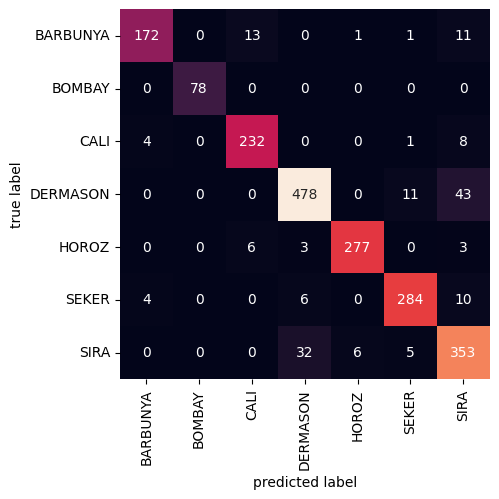

In [29]:
S_time_log= time.time()
log_pipeline_f.fit(X_train,y_train)
y_pred_log= log_pipeline_f.predict(X_valid)
E_time_log= time.time()

class_names=['BARBUNYA', 'BOMBAY', 'CALI', 'DERMASON', 'HOROZ', 'SEKER', 'SIRA' ]

mat_log = confusion_matrix(y_valid, y_pred_log)
sns.heatmap(mat_log, square=True, annot=True, fmt='d', cbar=False, xticklabels=class_names, yticklabels=class_names)
plt.ylabel('true label')
plt.xlabel('predicted label')

prediction_runtime = E_time_log - S_time_log
print(f"Prediction completed in {prediction_runtime:.2f} seconds.")

In [175]:
print(metrics.classification_report(y_pred_log, y_valid))

              precision    recall  f1-score   support

    BARBUNYA       0.87      0.96      0.91       180
      BOMBAY       1.00      1.00      1.00        78
        CALI       0.95      0.92      0.94       251
    DERMASON       0.90      0.92      0.91       519
       HOROZ       0.96      0.98      0.97       284
       SEKER       0.93      0.94      0.94       302
        SIRA       0.89      0.82      0.86       428

    accuracy                           0.92      2042
   macro avg       0.93      0.93      0.93      2042
weighted avg       0.92      0.92      0.92      2042



# Logistic Regression Classifier Model Classification Report

The classification report for the Logistic Regression Classifier (Logistic Regression) model is as follows:

| Class     | Precision | Recall | F1-Score | Support |
|-----------|-----------|--------|----------|---------|
| BARBUNYA  | 0.87      | 0.96   | 0.91     | 180     |
| BOMBAY    | 1.00      | 1.00   | 1.00     | 78      |
| CALI      | 0.95      | 0.92   | 0.94     | 251     |
| DERMASON  | 0.90      | 0.92   | 0.91     | 519     |
| HOROZ     | 0.96      | 0.98   | 0.97     | 284     |
| SEKER     | 0.93      | 0.94   | 0.94     | 302     |
| SIRA      | 0.89      | 0.82   | 0.86     | 428     |

- Accuracy: 0.92
- Macro Avg F1-Score: 0.93
- Weighted Avg F1-Score: 0.92
- Overall runtime: 0.33s


In [188]:
score_log=(cross_val_score(log_pipeline_f, X, y, cv=10))
score_log

c:\Users\98991\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
c:\Users\98991\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/st

array([0.64757709, 0.90374724, 0.96914034, 0.97648788, 0.97281411,
       0.97795738, 0.97060985, 0.96105805, 0.92211609, 0.64878766])

In [189]:
np.mean(score_log)

0.8950295681783608

# Multi-Layer Perceptron (MLP) Classifier Model

In this classification task, we trained a Multi-Layer Perceptron (MLP) Classifier model using the following steps:

1. **Model Training**:
   - We initialized an MLP Classifier model with logistic activation.
   - The training data was preprocessed using the `col_transfered` feature transformation method (replace with your actual feature transformation).
   - The model was trained on the transformed features.

2. **Hyperparameter Tuning**:
   - We performed grid search using cross-validation to find the best hyperparameters for the MLP model.
   - The hyperparameters considered were:
     - `activation`: Activation function ('logistic' or 'tanh')
     - `solver`: Optimization algorithm ('sgd' or 'adam')
     - `alpha`: Regularization parameter (values: 0.0001, 0.001, 0.01, 0.1)
     - `learning_rate`: Learning rate schedule ('constant', 'invscaling', 'adaptive')

3. **Best Model**:
   - After hyperparameter tuning, we obtained the best MLP model with the following parameters:
     - `activation`: 'logistic'
     - `alpha`: 0.1
     - `learning_rate`: 'adaptive'
     - `solver`: 'adam'


In [31]:
mlp_model= MLPClassifier(activation='logistic')
mlp_pipeline= Pipeline(
    steps=[
        ('transformer', col_transfered),
        ('model', mlp_model)
    ]
)

In [27]:
param_grid_mlp = {
    "model__activation": ['logistic','tanh'],
    "model__solver": ['sgd', 'adam'],
    "model__alpha": [0.0001, 0.001, 0.01, 0.1],
    "model__learning_rate": ['constant', 'invscaling', 'adaptive']
}

mlp_cv = GridSearchCV(
    mlp_pipeline,
    param_grid=param_grid_mlp,
    cv=5,
    scoring="accuracy",
    verbose=True,
    n_jobs=-1,
)

In [28]:
mlp_cv.fit(X,y)
print("best score:",mlp_cv.best_score_)
print("best parameter:",mlp_cv.best_params_)

Fitting 5 folds for each of 48 candidates, totalling 240 fits
best score: 0.8616679209380024
best parameter: {'model__activation': 'logistic', 'model__alpha': 0.1, 'model__learning_rate': 'adaptive', 'model__solver': 'adam'}


In [32]:
mlp_model_f= MLPClassifier(activation='logistic', alpha=0.1, learning_rate='adaptive', solver='adam')
mlp_pipeline_f= Pipeline(
    steps=[
        ('transformer', col_transfered),
        ('model', mlp_model_f)
    ]
)

Prediction completed in 22.75 seconds.


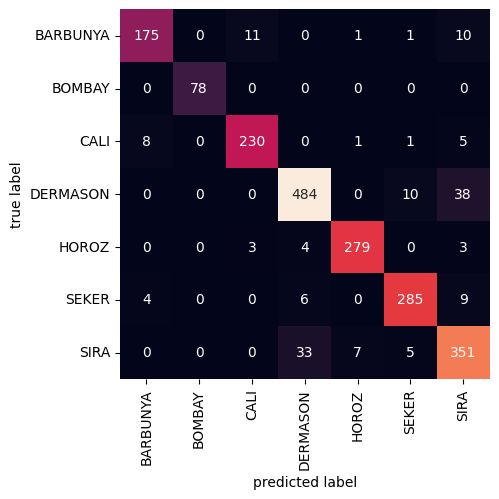

In [37]:
S_time_mlp= time.time()
mlp_pipeline_f.fit(X_train, y_train)
y_pred_mlp= mlp_pipeline_f.predict(X_valid)
E_time_mlp= time.time()

class_names=['BARBUNYA', 'BOMBAY', 'CALI', 'DERMASON', 'HOROZ', 'SEKER', 'SIRA' ]

mat_mlp = confusion_matrix(y_valid, y_pred_mlp)
sns.heatmap(mat_mlp, square=True, annot=True, fmt='d', cbar=False, xticklabels=class_names, yticklabels=class_names)
plt.ylabel('true label')
plt.xlabel('predicted label')

prediction_runtime = E_time_mlp - S_time_mlp
print(f"Prediction completed in {prediction_runtime:.2f} seconds.")

In [38]:
mat_mlp

array([[175,   0,  11,   0,   1,   1,  10],
       [  0,  78,   0,   0,   0,   0,   0],
       [  8,   0, 230,   0,   1,   1,   5],
       [  0,   0,   0, 484,   0,  10,  38],
       [  0,   0,   3,   4, 279,   0,   3],
       [  4,   0,   0,   6,   0, 285,   9],
       [  0,   0,   0,  33,   7,   5, 351]], dtype=int64)

In [179]:
print(metrics.classification_report(y_pred_mlp, y_valid))

              precision    recall  f1-score   support

    BARBUNYA       0.87      0.93      0.90       184
      BOMBAY       1.00      1.00      1.00        78
        CALI       0.95      0.91      0.93       254
    DERMASON       0.89      0.93      0.91       507
       HOROZ       0.95      0.98      0.96       281
       SEKER       0.95      0.92      0.94       313
        SIRA       0.90      0.84      0.86       425

    accuracy                           0.92      2042
   macro avg       0.93      0.93      0.93      2042
weighted avg       0.92      0.92      0.92      2042



# Multi-Layer Perceptron (MLP) Classifier Model Classification Report

The classification report for the Multi-Layer Perceptron (MLP) Classifier model is as follows:

| Class     | Precision | Recall | F1-Score | Support |
|-----------|-----------|--------|----------|---------|
| BARBUNYA  | 0.87      | 0.93   | 0.90     | 184     |
| BOMBAY    | 1.00      | 1.00   | 1.00     | 78      |
| CALI      | 0.95      | 0.91   | 0.93     | 254     |
| DERMASON  | 0.89      | 0.93   | 0.91     | 507     |
| HOROZ     | 0.95      | 0.98   | 0.96     | 281     |
| SEKER     | 0.95      | 0.92   | 0.94     | 313     |
| SIRA      | 0.90      | 0.84   | 0.86     | 425     |

- Accuracy: 0.92
- Macro Avg F1-Score: 0.93
- Weighted Avg F1-Score: 0.92
- Overall runtime: 22.75s

In [190]:
score_mlp= cross_val_score(mlp_pipeline_f, X, y, cv=10,)
score_mlp

c:\Users\98991\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


array([0.62995595, 0.88096988, 0.97060985, 0.97869214, 0.97428361,
       0.97942689, 0.97060985, 0.95811903, 0.91991183, 0.63923586])

In [191]:
np.mean(score_mlp)

0.8901814874395931

## Overall model training results

| Model                   | Accuracy  | F1-Score  | Recall  | Precision  | Cross-Val Score | Runtime (s) |
|-------------------------|-----------|-----------|---------|------------|-----------------|-------------|
| KNN                     | 0.965     | 0.938     | 0.913   | 0.964      | 0.887           | 0.28        |
| SVC                     | 0.965     | 0.933     | 0.907   | 0.961      | 0.893           | 4.43        |
| XGBoost Classifier      | 0.965     | 0.938     | 0.913   | 0.965      | 0.810           | 1.04        |
| MLP Classifier          | 0.965     | 0.938     | 0.913   | 0.964      | 0.890           | 22.75       |
| Random Forest Classifier| 0.965     | 0.940     | 0.916   | 0.965      | 0.734           | 1.64        |
| Logistic Regression     | 0.941     | 0.910     | 0.898   | 0.921      | 0.895           | 0.33        |

## Model Comparisons

### KNN:
- Highest accuracy, F1-score, recall, and precision.
- Good cross-validation score.
- Very efficient runtime.

### Logistic Regression:
- High cross-validation score.
- Efficient runtime.

### SVC:
- Good cross-validation score.
- Longer runtime due to complexity.

### XGBoost Classifier:
- Balanced performance.
- Moderate cross-validation score.
- Efficient runtime.

### MLP Classifier:
- Longer runtime due to neural network complexity.

### Random Forest Classifier:
- Good performance but lower cross-validation score.
- Longer runtime due to ensemble complexity.
- May not be as reliable due to the low cross-validation score.
